# Data analysis of the RD2022 data set

In [1]:
import os
import glob
import zipfile
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np
from xml.etree import ElementTree
from xml.dom import minidom
import collections
import seaborn as sns
import pandas as pd
import json
%matplotlib inline

np.random.seed(42)

In [28]:
cwd = os.getcwd()
# os.chdir('..')
print(cwd)
base_path = cwd
data_folder_name = 'RDD2022'
data_folder_path = os.path.join(cwd, data_folder_name)
extension = ".zip"
dir_name = data_folder_path
print(data_folder_path)
print(dir_name)
import os
import cv2
import  xml.dom.minidom

c:\Users\tinus\V2023\TDT4265_project
c:\Users\tinus\V2023\TDT4265_project\RDD2022
c:\Users\tinus\V2023\TDT4265_project\RDD2022


#### Below we unzip the files in the RDD2022 datasat. It should do nothing if already unzipped 

In [3]:
# Code retrieved from https://stackoverflow.com/questions/31346790/unzip-all-zipped-files-in-a-folder-to-that-same-folder-using-python-2-7-5

os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension): # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file
os.chdir(cwd)

#### Below we print the folder structure. Notice Chine_drone does not have a test set

In [ ]:
# Function created using chatGPT
def print_folder_structure(path, indentation=''):
    """
    Prints the folder structure of a given path with indentation for each level, omitting files.
    
    Args:
    - path (str): The path of the folder structure to be printed.
    - indentation (str): The indentation string for each level. Default is an empty string.
    """
    # Check if path is a directory
    if os.path.isdir(path):
        # Print the current folder name
        print(indentation + os.path.basename(path) + '/')
        # Get the list of items in the folder
        items = os.listdir(path)
        # Sort the items alphabetically
        items.sort()
        # Recursively print the folder structure for each item
        for item in items:
            item_path = os.path.join(path, item)
            # Check if item is a directory
            if os.path.isdir(item_path):
                print_folder_structure(item_path, indentation + '  ')

# Example usage
path = data_folder_path  # Replace with the actual path of the folder structure
# print_folder_structure(path)

RDD2022/
  China_Drone/
    train/
      annotations/
        xmls/
      images/
  China_MotorBike/
    test/
      images/
    train/
      annotations/
        xmls/
      images/
  Czech/
    test/
      images/
    train/
      annotations/
        xmls/
      images/
  India/
    test/
      images/
    train/
      annotations/
        xmls/
      images/
  Japan/
    test/
      images/
    train/
      annotations/
        xmls/
      images/
  Norway/
    test/
      images/
    train/
      annotations/
        xmls/
      images/
  United_States/
    test/
      images/
    train/
      annotations/
        xmls/
      images/


In [5]:
damage_types=["D00", "D10", "D20", "D40"]
# damageTypes=["D00", "D01", "D10", "D11", "D20", "D40", "D43", "D44"]
folder_names = os.listdir(data_folder_path)
print(folder_names)

['China_Drone', 'China_MotorBike', 'Czech', 'India', 'Japan', 'Norway', 'United_States']


In [6]:
# Code from https://www.youtube.com/watch?v=Ciy1J97dbY0
# Code fromhttps://github.com/sekilab/RoadDamageDetector/blob/master/RoadDamageDatasetTutorial.ipynb
# the number of total images and total labels.
cls_names = []
total_images = 0
cls_names_Norway = []
total_images_Norway = 0
for folder_name in folder_names:
    
    file_list = [filename for filename in os.listdir(os.path.join(data_folder_path, folder_name, 'train', 'Annotations', 'xmls')) if not filename.startswith('.')]
    for file in file_list:

        total_images = total_images + 1
        if file =='.DS_Store':
            pass
        else:
            infile_xml = open(os.path.join(data_folder_path, folder_name,'train', 'Annotations', 'xmls', file))
            tree = ElementTree.parse(infile_xml)
            root = tree.getroot()
            for obj in root.iter('object'):
                cls_name = obj.find('name').text
                cls_names.append(cls_name)
                if 'Norway' in folder_name:
                    cls_names_Norway.append(cls_name)
                    total_images_Norway += 1
print("total")
print("# of images：" + str(total_images))
print("# of labels：" + str(len(cls_names)))

total
# of images：38385
# of labels：65712


D00 : 26016
D10 : 11830
D20 : 10617
D40 : 6544


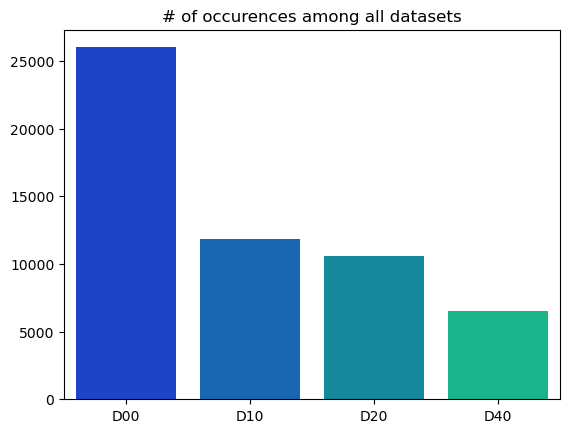

In [7]:
count_dict = collections.Counter(cls_names)
cls_count = []
for damage_type in damage_types:
    print(str(damage_type) + ' : ' + str(count_dict[damage_type]))
    cls_count.append(count_dict[damage_type])
    
sns.set_palette("winter", 4)
sns.barplot(x = damage_types, y = cls_count).set(title = '# of occurences among all datasets')
plt.show()

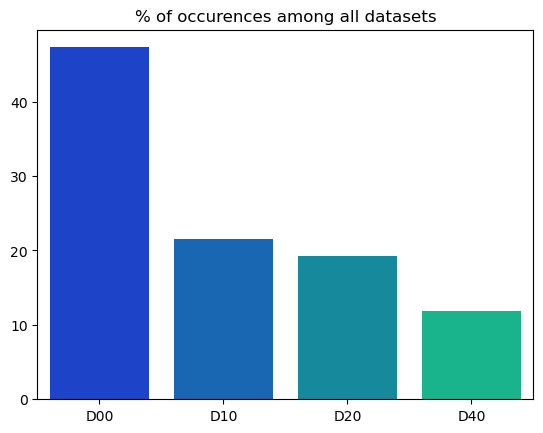

In [8]:
tot_count = sum(cls_count)
cls_count_percentage = [count/tot_count*100 for count in cls_count]
sns.set_palette("winter", 4)
sns.barplot(x = damage_types, y = cls_count_percentage).set(title = '% of occurences among all datasets')
plt.show()

#### We can see a significant inbalance in the dataset. Among the 38385 images there are 65712 labels found, and almost 50% of them are D00: Longtitudal. We check the Norwegian dataset to see if it is relatively similar to the dataset at an aggragated level (at all locations)

D00 : 8570
D10 : 1730
D20 : 468
D40 : 461


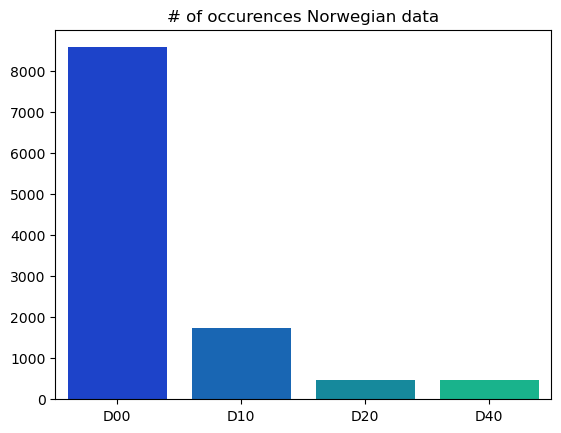

Counter({'D00': 8570, 'D10': 1730, 'D20': 468, 'D40': 461})


In [9]:
count_dict_Norway = collections.Counter(cls_names_Norway)
cls_count_Norway = []
for damage_type in damage_types:
    print(str(damage_type) + ' : ' + str(count_dict_Norway[damage_type]))
    cls_count_Norway.append(count_dict_Norway[damage_type])
    
sns.set_palette("winter", 4)
sns.barplot(x = damage_types, y = cls_count_Norway).set(title = '# of occurences Norwegian data')
plt.show()
print(count_dict_Norway)

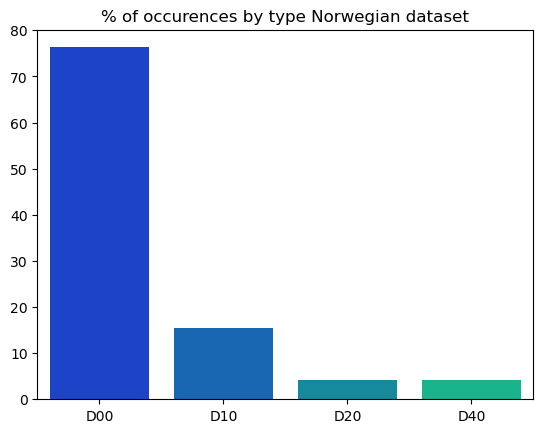

In [10]:
tot_count_Norway = sum(cls_count_Norway)
cls_count_percentage_Norway = [count/tot_count_Norway*100 for count in cls_count_Norway]
sns.set_palette("winter", 4)
sns.barplot(x = damage_types, y = cls_count_percentage_Norway).set(title = '% of occurences by type Norwegian dataset')
plt.show()

#### From the above plots, we can see that the Norwegian dataset is extremely unbalanced, and constitutes almost 80% logtitudal cracks. We therefore repeat the above analysis country by country, to gain knowledge of how we can handle this class imbalance.

In [11]:
country_statistics = dict()
total_images_by_country = dict()
for folder_name in folder_names:
    cls_names = []
    total_images = 0
    file_list = [filename for filename in os.listdir(os.path.join(data_folder_path, folder_name, 'train', 'Annotations', 'xmls')) if not filename.startswith('.')]
    for file in file_list:

        total_images = total_images + 1
        if file =='.DS_Store':
            pass
        else:
            infile_xml = open(os.path.join(data_folder_path, folder_name,'train', 'Annotations', 'xmls', file))
            tree = ElementTree.parse(infile_xml)
            root = tree.getroot()
            for obj in root.iter('object'):
                cls_name = obj.find('name').text
                cls_names.append(cls_name)
    total_images_by_country[folder_name] = total_images
    count_dict = collections.Counter(cls_names)
    country_statistics[folder_name] = dict()
    for damage_type in damage_types:
        country_statistics[folder_name][damage_type] = count_dict[damage_type]
#     country_statistics[folder_name]['total_images'] = total_images

In [12]:
columns = ['Source', 'classification', 'num_classified']
pandas_dict = {key: [] for key in columns}
for key, value in country_statistics.items():
    for subkey, subvalue in value.items():
        pandas_dict['Source'].append(key)
        pandas_dict['classification'].append(subkey)
        pandas_dict['num_classified'].append(subvalue)

In [13]:
df = pd.DataFrame(pandas_dict)

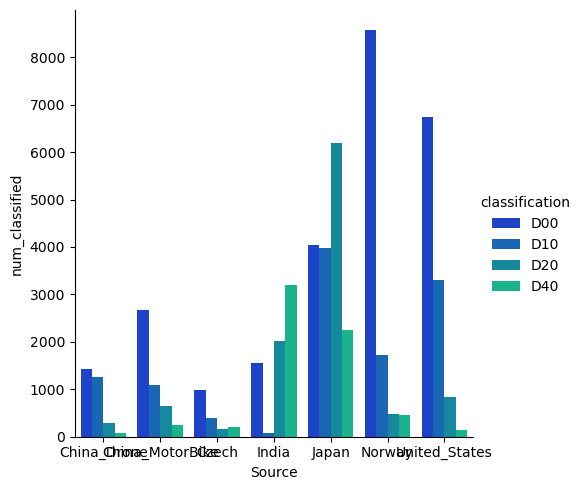

In [14]:
sns.catplot(x = 'Source', y = 'num_classified', hue = 'classification', data = df, kind = 'bar')

#### From the above plot we see that Norway is very domianted by longtitudal cracks. The Unites States set looks similar wrt. number of occurences of each type. Notice that japan and india contain many D20 and D40 instances, which could be important to keep in mind if our model is poor at predicted these categories on the Norwegian dataset.

In [15]:
print(folder_names)

['China_Drone', 'China_MotorBike', 'Czech', 'India', 'Japan', 'Norway', 'United_States']


In [27]:
print(f'Number of images in selected datasets:')
for folder in folder_names:
    print(f'{folder}: {total_images_by_country[folder]}')

print(f"In Total: {sum([total_images_by_country[folder] for folder in folder_names])}")

Number of images in selected datasets:
China_Drone: 2401
China_MotorBike: 1977
Czech: 2829
India: 7706
Japan: 10506
Norway: 8161
United_States: 4805
In Total: 38385


In [29]:
# Code from: https://piyush-kulkarni.medium.com/visualize-the-xml-annotations-in-python-c9696ba9c188


def save_images_with_bbox_to_viz_folder(folder_name):
    folder = folder_name
    image_path=os.path.join(data_folder_path, folder, 'train', 'images')
    annotation_path=os.path.join(data_folder_path, folder, 'train', 'annotations', 'xmls')
    
    files_name = os.listdir(image_path)
    # print(files_name)
    for filename_ in files_name[:30:]:
        filename, extension= os.path.splitext(filename_)
        img_path =os.path.join(image_path, filename + '.jpg')
        xml_path =os.path.join(annotation_path, filename + '.xml')
        img = cv2.imread(img_path)
        if img is None:
            pass
        dom = xml.dom.minidom.parse(xml_path)
        root = dom.documentElement
        objects=dom.getElementsByTagName("object")
        i=0
        for object in objects:  
            bndbox = root.getElementsByTagName('bndbox')[i]
            xmin = bndbox.getElementsByTagName('xmin')[0]
            ymin = bndbox.getElementsByTagName('ymin')[0]
            xmax = bndbox.getElementsByTagName('xmax')[0]
            ymax = bndbox.getElementsByTagName('ymax')[0]
            xmin_data=xmin.childNodes[0].data
            ymin_data=ymin.childNodes[0].data
            xmax_data=xmax.childNodes[0].data
            ymax_data=ymax.childNodes[0].data
            obj_name = obj.find('name').text
            i= i +1 
            cv2.rectangle(img,(int(float(xmin_data)),int(float(ymin_data)),int(float(xmax_data)),int(float(ymax_data))),(55,255,155),5)
        flag=0
        flag=cv2.imwrite(os.path.join(base_path, 'visualization', "{}.jpg".format(filename)),img)
        if(flag):
            print(filename,"done")

In [19]:

def draw_boxes_on_image(image, xmin, ymin, xmax, ymax, label, color):
    # Function to draw boundary boxes on the image
    cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, 5)
    cv2.putText(image, label, (int(xmin), int(ymin) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

def save_modified_images_with_boxes(image_folder, annotation_folder, saved_folder):
    # Function to save modified images with boundary boxes
    
    # Get the list of image files
    image_files = os.listdir(image_folder)
    
    # Define a color mapping for different labels
    color_mapping = {
        'D00': (0, 255, 0),  # Green
        'D10': (0, 0, 255),  # Blue
        'D20': (255, 0, 0),  # Red
        'D40': (255, 255, 0)  # Yellow
    }

    # Loop through each image file
    for image_file in image_files[:30:]:
        # Extract the filename without extension
        filename, extension = os.path.splitext(image_file)

        # Check if corresponding XML annotation file exists
        xml_file = os.path.join(annotation_folder, filename + '.xml')
        if not os.path.exists(xml_file):
            print(f"Annotation file not found for image '{image_file}', skipping...")
            continue

        # Load the image
        image_path = os.path.join(image_folder, image_file)
        image = cv2.imread(image_path)
        if image is None:
            print(f"Failed to load image '{image_file}', skipping...")
            continue

        # Parse the XML annotation file
        dom = xml.dom.minidom.parse(xml_file)
        root = dom.documentElement
        objects = dom.getElementsByTagName("object")

        # Loop through each object in the annotation
        for obj in objects:
            xmin = float(obj.getElementsByTagName('xmin')[0].childNodes[0].data)
            ymin = float(obj.getElementsByTagName('ymin')[0].childNodes[0].data)
            xmax = float(obj.getElementsByTagName('xmax')[0].childNodes[0].data)
            ymax = float(obj.getElementsByTagName('ymax')[0].childNodes[0].data)
            label = obj.getElementsByTagName('name')[0].childNodes[0].data

            # Get the color for the label from the color mapping
            color = color_mapping.get(label, (255, 255, 255))  # Default color is white

            # Draw the boundary box and label on the image
            draw_boxes_on_image(image, xmin, ymin, xmax, ymax, label, color)


        # Save the modified image with boundary boxes
        saved_path = os.path.join(saved_folder, filename + '_saved.jpg')
        cv2.imwrite(saved_path, image)
#         print(f"Saved modified image with boundary boxes: '{saved_path}'")

In [20]:
image_path=os.path.join(data_folder_path, folder, 'train', 'images')
annotation_path=os.path.join(data_folder_path, folder, 'train', 'annotations', 'xmls')
save_path = os.path.join(base_path, 'visualization', folder)
if not os.path.exists(save_path):
    os.makedirs(save_path)

save_modified_images_with_boxes(image_path, annotation_path, save_path)

In [188]:
def draw_boxes_on_image(image, xmin, ymin, xmax, ymax, label, color):
    # Function to draw boundary boxes and labels on the image
    cv2.rectangle(image, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, 5)
    cv2.putText(image, label, (int(xmin), int(ymin) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

def display_modified_images_with_boxes(image_folder, annotation_folder, num_images = -1):
    # Function to display modified images with boundary boxes and labels

    # Define a color mapping for different labels
    color_mapping = {
        'D00': (0, 255, 0),  # Green
        'D10': (0, 0, 255),  # Blue
        'D20': (255, 0, 0),  # Red
        'D40': (255, 255, 0)  # Yellow
    }

    # Get the list of image files
    image_files = os.listdir(image_folder)

    # Loop through each image file
    if num_images == -1:
        num_images = len(image_files)
    for image_file in image_files[:num_images:]:
        # Extract the filename without extension
        filename, extension = os.path.splitext(image_file)

        # Check if corresponding XML annotation file exists
        xml_file = os.path.join(annotation_folder, filename + '.xml')
        if not os.path.exists(xml_file):
            print(f"Annotation file not found for image '{image_file}', skipping...")
            continue

        # Load the image
        image_path = os.path.join(image_folder, image_file)
        image = cv2.imread(image_path)
        if image is None:
            print(f"Failed to load image '{image_file}', skipping...")
            continue

        # Parse the XML annotation file
        dom = xml.dom.minidom.parse(xml_file)
        root = dom.documentElement
        objects = dom.getElementsByTagName("object")

        # Loop through each object in the annotation
        for obj in objects:
            xmin = float(obj.getElementsByTagName('xmin')[0].childNodes[0].data)
            ymin = float(obj.getElementsByTagName('ymin')[0].childNodes[0].data)
            xmax = float(obj.getElementsByTagName('xmax')[0].childNodes[0].data)
            ymax = float(obj.getElementsByTagName('ymax')[0].childNodes[0].data)
            label = obj.getElementsByTagName('name')[0].childNodes[0].data

            # Get the color for the label from the color mapping
            color = color_mapping.get(label, (255, 255, 255))  # Default color is white

            # Draw the boundary box and label on the image
            draw_boxes_on_image(image, xmin, ymin, xmax, ymax, label, color)

        # Display the modified image with boundary boxes in a Jupyter Notebook
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()


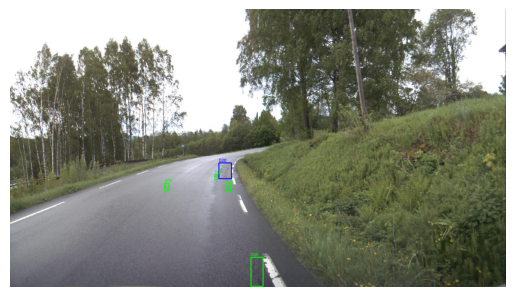

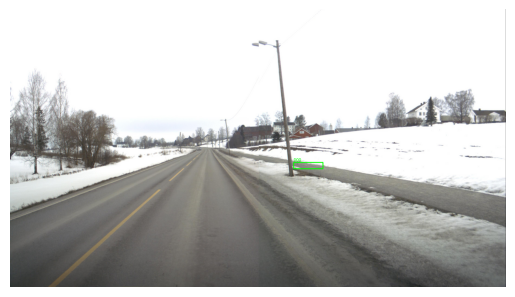

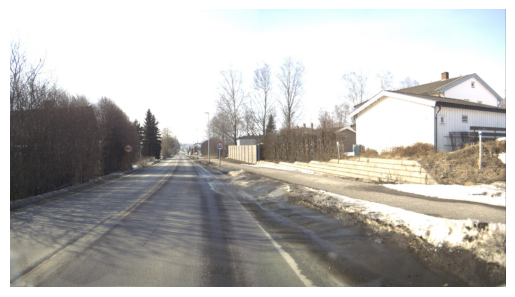

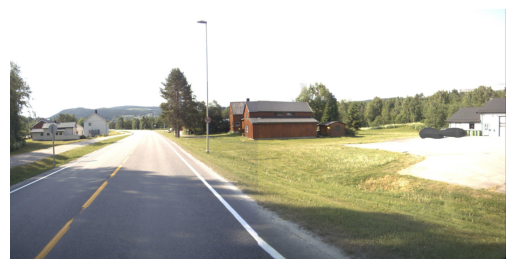

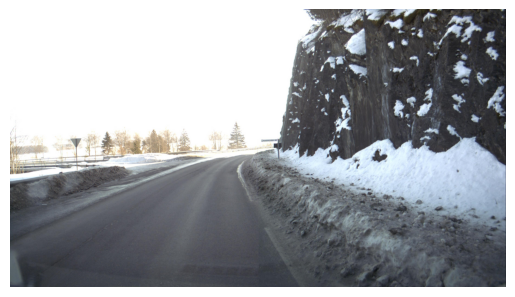

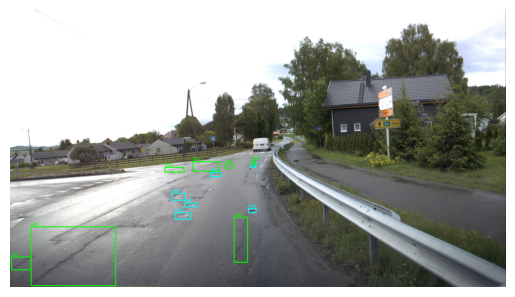

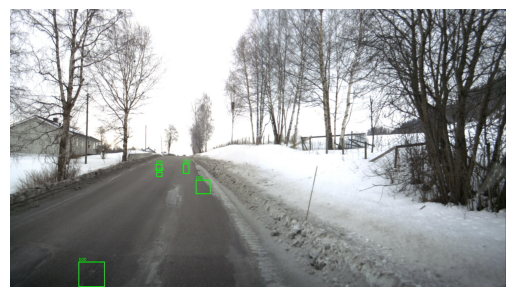

In [85]:
folder = 'Norway'
 
image_path=os.path.join(data_folder_path, folder, 'train', 'images')
annotation_path=os.path.join(data_folder_path, folder, 'train', 'annotations', 'xmls')
display_modified_images_with_boxes(image_path, annotation_path, 7)

In [33]:
def get_image_sizes(image_folder, image_filter=".jpg"):
    """
    Get sizes (width, height) of all images in the given folder that match the specified filter.
    
    Args:
        image_folder (str): The path to the image folder.
        image_filter (str): The image file extension filter. Defaults to ".jpg".
    
    Returns:
        list: A list of (width, height) tuples for all the images in the folder.
    """
    image_sizes = []
    image_files = [f for f in os.listdir(image_folder) if f.endswith(image_filter)]
    for image_file in image_files:
        image_path = os.path.join(image_folder, image_file)
        image = cv2.imread(image_path)
        if image is not None:
            height, width, _ = image.shape
            if _ != 3:
                print(_)
            image_sizes.append((width, height))
    return image_sizes

In [34]:
# norway = get_image_sizes(image_path)

In [36]:
sizes_dict = dict()
image_paths = [os.path.join(data_folder_path, folder, 'train', 'images') for folder in folder_names]
# print(image_paths)

In [40]:
# for idx, path in enumerate(image_paths):
#     sizes_dict[folder_names[idx]] = get_image_sizes(path)
# with open("image_sizes.json", "w") as outfile:
#     json.dump(sizes_dict, outfile)



In [41]:
with open('image_sizes.json') as json_file:
    sizes_dict = json.load(json_file)

In [42]:
for key, value in sizes_dict.items():
    print('For dataset', key)
    unique = []
    for item in value:
        if item not in unique:
            unique.append(item)
    for size in unique:
        print(f"Size {size} occurs: {value.count(size)} times")
    print('')

For dataset China_Drone
Size [512, 512] occurs: 2401 times

For dataset China_MotorBike
Size [512, 512] occurs: 1977 times

For dataset Czech
Size [600, 600] occurs: 2829 times

For dataset India
Size [720, 720] occurs: 7706 times

For dataset Japan
Size [600, 600] occurs: 10187 times
Size [1080, 1080] occurs: 48 times
Size [1024, 1024] occurs: 147 times
Size [540, 540] occurs: 124 times

For dataset Norway
Size [3650, 2044] occurs: 923 times
Size [3643, 2041] occurs: 2896 times
Size [4040, 2035] occurs: 4342 times

For dataset United_States
Size [640, 640] occurs: 4805 times



In [43]:
# norway_test_set_image_path = os.path.join(data_folder_path, 'Norway', 'test', 'images')
# norway_test_set_image_sizes = {}
# norway_test_set_image_sizes['norway'] = get_image_sizes(norway_test_set_image_path)
# with open("Norway_test_set_sizes.json", "w") as outfile:
#     json.dump(norway_test_set_image_sizes, outfile)


In [46]:
with open('Norway_test_set_sizes.json') as json_file:
    norway_test_set_image_sizes = json.load(json_file)

In [50]:
print('Norway test set sizes')
l = norway_test_set_image_sizes['norway']
def get_unique_elements(input_list):
    unique_list = []
    for element in input_list:
        if element not in unique_list:
            unique_list.append(element)
    return unique_list
for pair in get_unique_elements(l):
    print(pair, 'occurs', l.count(pair), 'times')

Norway test set sizes
[3650, 2044] occurs 223 times
[4040, 2035] occurs 1058 times
[3643, 2041] occurs 759 times


In [52]:
img_size = 960
print(f'Number of {img_size}x{img_size} images that would fit in the Norway set for different sizes:')
for w, y in get_unique_elements(l):
    print(w, y)
    print('width', w/960, 'height', y/960)

Number of 960x960 images that would fit in the Norway set for different sizes:
3650 2044
width 3.8020833333333335 height 2.129166666666667
4040 2035
width 4.208333333333333 height 2.1197916666666665
3643 2041
width 3.794791666666667 height 2.1260416666666666


In [ ]:
# test_set_path = os.path.join(data_folder_path, 'test_set')
# test_set_images_path = os.path.join(test_set_path, 'images')
# test_set_labels_path = os.path.join(test_set_path, 'annotations', 'xmls')

# if not os.path.exists(test_set_images_path):
#     os.makedirs(test_set_images_path)

# if not os.path.exists(test_set_labels_path):
#     os.makedirs(test_set_labels_path)

In [ ]:
# test_set_path = os.path.join(data_folder_path, 'test_set_augmented')
# test_set_images_path = os.path.join(test_set_path, 'images')
# test_set_labels_path = os.path.join(test_set_path, 'annotations', 'xmls')

# if not os.path.exists(test_set_images_path):
#     os.makedirs(test_set_images_path)

# if not os.path.exists(test_set_labels_path):
#     os.makedirs(test_set_labels_path)

## Getting bbox sizes and images without relevant objects (Chatgpt is used to provide a skeleton for wanted functionality and then manually adjusted and tested)

In [56]:
import xml.etree.ElementTree as ET

def get_bounding_box_size_and_missing_files(folder_name):
    annotations_folder = os.path.join(data_folder_path, folder_name, 'train', 'annotations', 'xmls')
    box_sizes = []
    missing_files = []
    for file in os.listdir(annotations_folder):
        if file.endswith('.xml'):
            xml_path = os.path.join(annotations_folder, file)
            tree = ET.parse(xml_path)
            root = tree.getroot()
            has_object = False
            for obj in root.findall('object'):
                obj_class = obj.find('name').text
                if obj_class in ['D00', 'D10', 'D20', 'D40']:
                    has_object = True
                    bbox = obj.find('bndbox')
                    xmin = float(bbox.find('xmin').text)
                    ymin = float(bbox.find('ymin').text)
                    xmax = float(bbox.find('xmax').text)
                    ymax = float(bbox.find('ymax').text)
                    box_width = xmax - xmin
                    box_height = ymax - ymin
                    box_sizes.append((box_width, box_height))
            if not has_object:
                missing_files.append(file)
    return box_sizes, missing_files

In [76]:
dic = dict()
for folder_name in folder_names:
    dic[folder_name] = get_bounding_box_size_and_missing_files(folder_name)

contains_objects_dic = {}
for key, value in dic.items():
    contains_objects_dic[key] = [len(sizes_dict[key]), len(value[1]), len(sizes_dict[key]) - len(value[1])]

for key, value in dic.items():
    print('For dataset', key, 'we have:')
    print('Bound box statistics:')
    print(f'Num objects: {len(value[0])}, average box size = {np.mean(value[0])}, median box size = {np.median(value[0])}, min box size = {np.min(value[0])}, max box size = {np.max(value[0])}')
    print()

print(f'files without bounding boxes example: {dic["Norway"][1][0]}')

For dataset China_Drone we have:
Bound box statistics:
Num objects: 3068, average box size = 125.63820078226858, median box size = 81.5, min box size = 10.0, max box size = 511.0

For dataset China_MotorBike we have:
Bound box statistics:
Num objects: 4650, average box size = 156.9647311827957, median box size = 100.0, min box size = 4.0, max box size = 511.0

For dataset Czech we have:
Bound box statistics:
Num objects: 1745, average box size = 77.65730659025787, median box size = 65.0, min box size = 9.0, max box size = 550.0

For dataset India we have:
Bound box statistics:
Num objects: 6831, average box size = 144.3850095154443, median box size = 108.0, min box size = 12.0, max box size = 719.0

For dataset Japan we have:
Bound box statistics:
Num objects: 16470, average box size = 126.34043715846994, median box size = 92.0, min box size = 0.0, max box size = 1045.0

For dataset Norway we have:
Bound box statistics:
Num objects: 11229, average box size = 222.80177175171428, median 

In [62]:
for key, value in contains_objects_dic.items():
    print('For dataset', key, 'we have:')
    print(f'{value[0]} images, {value[1]} images without objects, {value[2]} images with objects')

For dataset China_Drone we have:
2401 images, 482 images without objects, 1919 images with objects
For dataset China_MotorBike we have:
1977 images, 43 images without objects, 1934 images with objects
For dataset Czech we have:
2829 images, 1757 images without objects, 1072 images with objects
For dataset India we have:
7706 images, 4483 images without objects, 3223 images with objects
For dataset Japan we have:
10506 images, 2606 images without objects, 7900 images with objects
For dataset Norway we have:
8161 images, 5247 images without objects, 2914 images with objects
For dataset United_States we have:
4805 images, 0 images without objects, 4805 images with objects


In [152]:

def create_folder_structure(root_directory):
    # Create the root directory
    os.makedirs(root_directory, exist_ok=True)
    
    # Define the subdirectory names and their structure
    subdirs = {
        "China_Drone": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        },
        "China_MotorBike": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        },
        "Czech": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        },
        "India": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        },
        "Japan": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        },
        "Norway": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        },
        "United_States": {
            "train": {
                "annotations": {
                    "xmls": None
                },
                "images": None
            }
        }
    }
    
    # Create the subdirectories and their structure
    for subdir, structure in subdirs.items():
        subdir_path = os.path.join(root_directory, subdir)
        os.makedirs(subdir_path, exist_ok=True)
        
        for subsubdir, substructure in structure.items():
            subsubdir_path = os.path.join(subdir_path, subsubdir)
            os.makedirs(subsubdir_path, exist_ok=True)
            
            for subsubsubdir, subsubstructure in substructure.items():
                subsubsubdir_path = os.path.join(subsubdir_path, subsubsubdir)
                os.makedirs(subsubsubdir_path, exist_ok=True)
                
                if subsubstructure:
                    for subsubsubsubdir, _ in subsubstructure.items():
                        subsubsubsubdir_path = os.path.join(subsubsubdir_path, subsubsubsubdir)
                        os.makedirs(subsubsubsubdir_path, exist_ok=True)
                
    print(f"Created folder structure in {root_directory}")

In [156]:
modified_data_folder_name = 'RDD2022_modified'
create_folder_structure(modified_data_folder_name)

Created folder structure in RDD2022_modified


In [189]:
def get_number_of_bounding_boxes_to_the_right_off(folder_name, x):
    annotations_folder = os.path.join(data_folder_path, folder_name, 'train', 'annotations', 'xmls')
    num_bboxes = 0
    files_without_bboxes = dic[folder_name][1]
    files_found = []
    for file in os.listdir(annotations_folder):
        if file in files_without_bboxes:
            continue
        if file.endswith('.xml'):
            xml_path = os.path.join(annotations_folder, file)
            tree = ET.parse(xml_path)
            root = tree.getroot()
            found = False
            for obj in root.findall('object'):
                obj_class = obj.find('name').text
                if obj_class in ['D00', 'D10', 'D20', 'D40']:
                    bbox = obj.find('bndbox')
                    xmax = float(bbox.find('xmax').text)
                    if xmax > x:
                        found = True
                        num_bboxes += 1
        if found:
            files_found.append(file)
    return num_bboxes, files_found

In [190]:
def get_number_of_bounding_boxes_above(folder_name, y):
    annotations_folder = os.path.join(data_folder_path, folder_name, 'train', 'annotations', 'xmls')
    num_bboxes = 0
    files_without_bboxes = dic[folder_name][1]
    files_found = []
    for file in os.listdir(annotations_folder):
        if file in files_without_bboxes:
            continue
        if file.endswith('.xml'):
            xml_path = os.path.join(annotations_folder, file)
            tree = ET.parse(xml_path)
            root = tree.getroot()
            found = False
            for obj in root.findall('object'):
                obj_class = obj.find('name').text
                if obj_class in ['D00', 'D10', 'D20', 'D40']:
                    bbox = obj.find('bndbox')
                    ymin = float(bbox.find('ymin').text)
                    if ymin < y:
                        found = True
                        num_bboxes += 1
        if found:
               files_found.append(file)
    return num_bboxes, files_found

def get_number_of_bounding_boxes_below(folder_name, y):
    annotations_folder = os.path.join(data_folder_path, folder_name, 'train', 'annotations', 'xmls')
    num_bboxes = 0
    files_without_bboxes = dic[folder_name][1]
    files_found = []
    for file in os.listdir(annotations_folder):
        if file in files_without_bboxes:
            continue
        if file.endswith('.xml'):
            xml_path = os.path.join(annotations_folder, file)
            tree = ET.parse(xml_path)
            root = tree.getroot()
            found = False
            for obj in root.findall('object'):
                obj_class = obj.find('name').text
                if obj_class in ['D00', 'D10', 'D20', 'D40']:
                    bbox = obj.find('bndbox')
                    ymax = float(bbox.find('ymax').text)
                    if y <= ymax:
                        found = True
                        num_bboxes += 1
        if found:
               files_found.append(file)
    return num_bboxes, files_found

# NOTE THAT THE Y AXIS IS INVERTED IN THE XML FILES. THAT IS, HIGHER Y VALUE MEANS LOWER IN THE IMAGE

In [192]:
folder_name = 'Norway'
print(f'Num files with bounding boxes in {folder_name}: {contains_objects_dic[folder_name][2]}')
for i in range(0, 4045, 320):
    print(f'Num bounding boxes to the right of x = {i}: {get_number_of_bounding_boxes_to_the_right_off(folder_name, i)[0]}')

Num files with bounding boxes in Norway: 2914
Num bounding boxes to the right of x = 0: 11229
Num bounding boxes to the right of x = 320: 10918
Num bounding boxes to the right of x = 640: 10030
Num bounding boxes to the right of x = 960: 8508
Num bounding boxes to the right of x = 1280: 6298
Num bounding boxes to the right of x = 1600: 3300
Num bounding boxes to the right of x = 1920: 1108
Num bounding boxes to the right of x = 2240: 328
Num bounding boxes to the right of x = 2560: 134
Num bounding boxes to the right of x = 2880: 83
Num bounding boxes to the right of x = 3200: 54
Num bounding boxes to the right of x = 3520: 30
Num bounding boxes to the right of x = 3840: 2


In [193]:
folder_name = 'Norway'
print(f'Num files with bounding boxes in {folder_name}: {contains_objects_dic[folder_name][2]}')
for i in np.arange(0, 2000, 320):
    print(f'Num bounding boxes above y = {i}: {get_number_of_bounding_boxes_above(folder_name, i)[0]}')

Num files with bounding boxes in Norway: 2914
Num bounding boxes above y = 0: 0
Num bounding boxes above y = 320: 1
Num bounding boxes above y = 640: 1
Num bounding boxes above y = 960: 2
Num bounding boxes above y = 1280: 3779
Num bounding boxes above y = 1600: 8823
Num bounding boxes above y = 1920: 11059


In [216]:
import numpy as np

folder_name = 'Norway'
print(f'Num files with bounding boxes in {folder_name}: {contains_objects_dic[folder_name][2]}')
for i in np.arange(0, 2000, 320)[::-1]:
    print(f'Num bounding boxes below y = {i}: {get_number_of_bounding_boxes_below(folder_name, i)[0]}')

Num files with bounding boxes in Norway: 2914
Num bounding boxes below y = 1920: 2339
Num bounding boxes below y = 1600: 5110
Num bounding boxes below y = 1280: 9360
Num bounding boxes below y = 960: 11228
Num bounding boxes below y = 640: 11228
Num bounding boxes below y = 320: 11228
Num bounding boxes below y = 0: 11229


In [264]:

def crop_and_save_bottom_left(image_path, crop_width, crop_height, output_path):
    with Image.open(image_path) as im:
        # Get the size of the input image
        img_width, img_height = im.size
        
        # Calculate the coordinates for the bottom left corner of the crop
        left = 0
        top = img_height - crop_height
        right = crop_width
        bottom = img_height
        
        # Crop the image using the calculated coordinates
        cropped_im = im.crop((left, top, right, bottom))
        
        # Save the cropped image to the specified output path
        cropped_im.save(output_path)

impath = os.path.join(image_path, 'Norway_000005.jpg')
outpath = 'cropped_once.jpg'
crop_and_save_bottom_left(impath, 960*3, 960*2, outpath)


In [274]:
# Chatgpt
def generate_xml_file(filename, width, height, objects, save_path):
    # Create the root element and set the version and encoding attributes
    root = ET.Element('annotation')
    root.set('version', '1.0')
    root.set('encoding', 'UTF-8')

    # Create the folder, filename, size, and segmented elements and add them to the root
    folder = ET.SubElement(root, 'folder')
    folder.text = 'images'
    filename_elem = ET.SubElement(root, 'filename')
    filename_elem.text = filename
    size = ET.SubElement(root, 'size')
    width_elem = ET.SubElement(size, 'width')
    width_elem.text = str(width)
    height_elem = ET.SubElement(size, 'height')
    height_elem.text = str(height)
    depth = ET.SubElement(size, 'depth')
    segmented = ET.SubElement(root, 'segmented')
    segmented.text = '0'

    # Iterate over the objects and create an object element for each one
    for obj in objects:
        obj_elem = ET.SubElement(root, 'object')

        # Create the name, truncated, occluded, difficult, and bndbox elements and add them to the object element
        name = ET.SubElement(obj_elem, 'name')
        name.text = obj[0]
        truncated = ET.SubElement(obj_elem, 'truncated')
        truncated.text = '0'
        occluded = ET.SubElement(obj_elem, 'occluded')
        occluded.text = '0'
        difficult = ET.SubElement(obj_elem, 'difficult')
        difficult.text = '0'
        bndbox = ET.SubElement(obj_elem, 'bndbox')
        xmin = ET.SubElement(bndbox, 'xmin')
        xmin.text = str(obj[1])
        ymin = ET.SubElement(bndbox, 'ymin')
        ymin.text = str(obj[3])
        xmax = ET.SubElement(bndbox, 'xmax')
        xmax.text = str(obj[2])
        ymax = ET.SubElement(bndbox, 'ymax')
        ymax.text = str(obj[4])

        # Create the attributes element and add a rotation attribute to it
        attributes = ET.SubElement(obj_elem, 'attributes')
        attribute = ET.SubElement(attributes, 'attribute')
        name = ET.SubElement(attribute, 'name')
        name.text = 'rotation'
        value = ET.SubElement(attribute, 'value')
        value.text = '0.0'

    # Create the XML file and write it to the specified path
    tree = ET.ElementTree(root)
    tree.write(save_path)


In [275]:
ids = ['a', 'b', 'c', 'd', 'e', 'f']
from PIL import Image

def is_bbox_in_crop(xmin, xmax, ymin, ymax, left, top, right, bottom):
    return xmin >= left and xmax <= right and ymin >= top and ymax <= bottom

def is_bbox_outside_crop(xmin, xmax, ymin, ymax, left, top, right, bottom):
    return xmin >= right or xmax <= left or ymin >= bottom or ymax <= top

def crop_and_save_imgs_and_xmls_by_folder_name(folder_name, x_interval, y_interval):
    annotations_folder = os.path.join(data_folder_path, folder_name, 'train', 'annotations', 'xmls')
    image_folder = os.path.join(data_folder_path, folder_name, 'train', 'images')
    annotations_save_folder = os.path.join(data_folder_path.replace('RDD2022', 'RDD2022_modified'), folder_name, 'train', 'annotations', 'xmls')
    image_save_folder = os.path.join(data_folder_path.replace('RDD2022', 'RDD2022_modified'), folder_name, 'train', 'images')
    for file in os.listdir(annotations_folder)[:20:]:
        if file.endswith('.xml'):
            filename = file.replace('.xml', '')
            xml_path = os.path.join(annotations_folder, file)
            tree = ET.parse(xml_path)
            root = tree.getroot()
            image_path = os.path.join(image_folder, file.replace('.xml', '.jpg'))
            with Image.open(image_path) as im:
                # Get the size of the input image
                img_width, img_height = im.size
                print('img_width, img_height: ')
                print(img_width, img_height)
                 # Create 3 x 2 grid of images

                 # Top should be a lower number than bottom
                left_pixels = [x_interval * i for i in range(3)]
                top_pixels = [img_height - y_interval * i for i in range(1, 3)]
                right_pixels = [x_interval * i for i in range(1, 4)]
                bottom_pixels = [img_height - y_interval * i for i in range(2)]
                # Adjust to account that pixel 0 in y directuon is at the top
                image_combos = []
                for indy, bottom in enumerate(bottom_pixels):
                    top = top_pixels[indy]
                    for indx, left in enumerate(left_pixels):
                        right = right_pixels[indx]
                    
                        image_combos.append((left, top, right, bottom))

                for indx, combo in enumerate(image_combos):
                    cropped_im = im.crop(combo)
                    cropped_im.save(os.path.join(image_save_folder, filename + '_' + ids[indx] + '.jpg'))
                    bounding_boxes_to_save = []
                    for obj in root.findall('object'):
                        obj_class = obj.find('name').text
                        if obj_class in ['D00', 'D10', 'D20', 'D40']:
                            bbox = obj.find('bndbox')
                            xmin = float(bbox.find('xmin').text)
                            xmax = float(bbox.find('xmax').text)
                            ymin = float(bbox.find('ymin').text)
                            ymax = float(bbox.find('ymax').text)
                            if is_bbox_outside_crop(xmin, xmax, ymin, ymax, *combo):
                                continue
                            if is_bbox_in_crop(xmin, xmax, ymin, ymax, *combo):
                                pass
                            else:
                                print('Occured for file: ' + filename + '_' + ids[indx] + '.jpg')
                                # Bbox is partially in crop
                                # Calculate new coordinates
                                xmin = max(xmin, combo[0])
                                xmax = min(xmax, combo[2])
                                ymin = max(ymin, combo[1])
                                ymax = min(ymax, combo[3])
                            # Adjust coordinates to be relative to the crop
                            xmin = xmin - combo[0]
                            xmax = xmax - combo[0]
                            ymin = ymin - combo[1]
                            ymax = ymax - combo[1]
                            bounding_boxes_to_save.append((obj_class, xmin, xmax, ymin, ymax))
                    xml_save_path = os.path.join(annotations_save_folder, filename + '_' + ids[indx] + '.xml')
                    generate_xml_file(filename + '_' + ids[indx] + '.jpg', x_interval, y_interval, bounding_boxes_to_save, xml_save_path)

x_interval = 960
y_interval = 960
crop_and_save_imgs_and_xmls_by_folder_name('Norway', x_interval, y_interval)

img_width, img_height: 
3650 2044
img_width, img_height: 
3643 2041
img_width, img_height: 
3643 2041
img_width, img_height: 
4040 2035
img_width, img_height: 
3643 2041
img_width, img_height: 
3650 2044
img_width, img_height: 
3643 2041
img_width, img_height: 
4040 2035
img_width, img_height: 
3650 2044
Occured for file: Norway_000008_a.jpg
Occured for file: Norway_000008_b.jpg
img_width, img_height: 
3650 2044
Occured for file: Norway_000009_a.jpg
Occured for file: Norway_000009_a.jpg
Occured for file: Norway_000009_b.jpg
Occured for file: Norway_000009_b.jpg
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035
img_width, img_height: 
3643 2041
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035
img_width, img_height: 
4040 2035


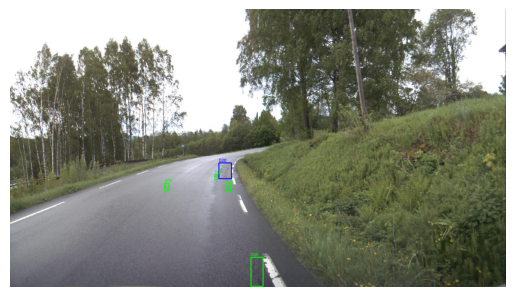

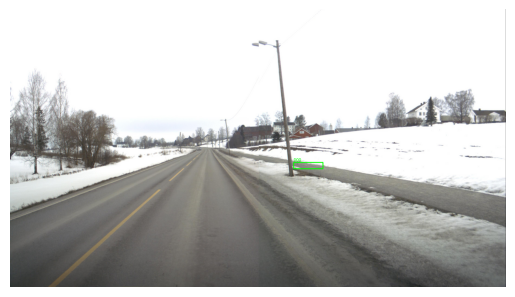

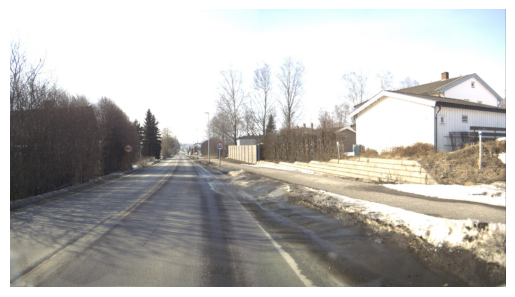

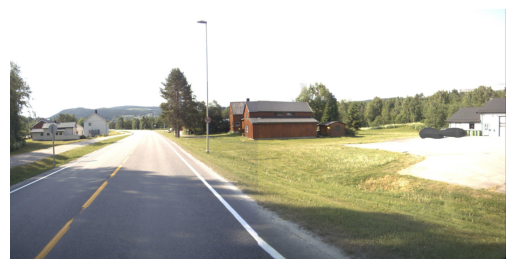

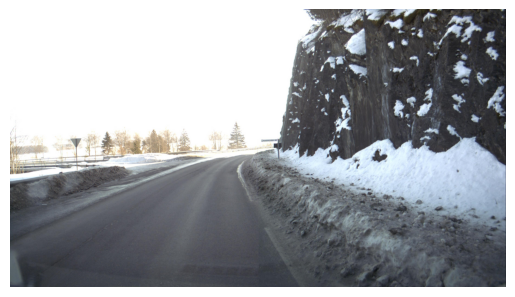

...

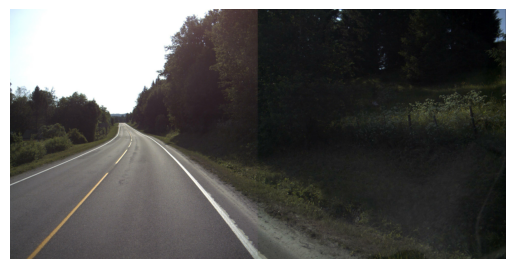

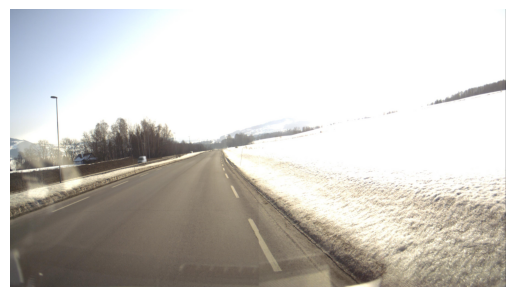

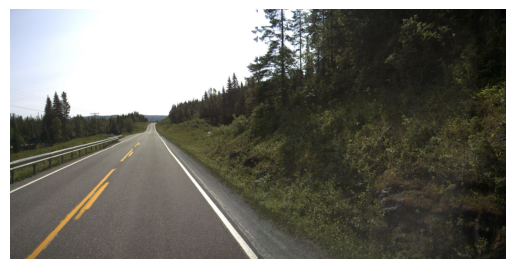

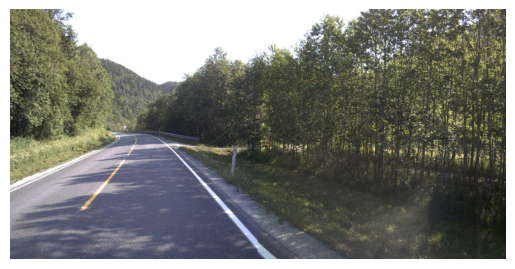

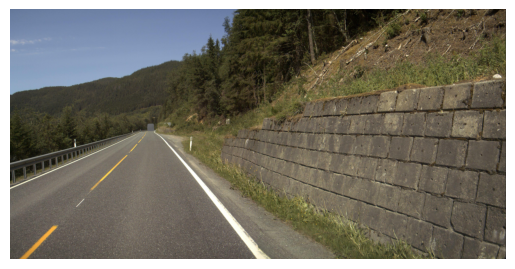

In [272]:
OG_image_path = os.path.join(data_folder_path, 'Norway', 'train', 'images')
OG_annotation_path = os.path.join(data_folder_path, 'Norway', 'train', 'annotations', 'xmls')
modified_image_path = os.path.join(data_folder_path.replace('RDD2022', 'RDD2022_modified'), 'Norway', 'train', 'images')
modified_annotation_path = os.path.join(data_folder_path.replace('RDD2022', 'RDD2022_modified'), 'Norway', 'train', 'annotations', 'xmls')
display_modified_images_with_boxes(OG_image_path, OG_annotation_path, 20)

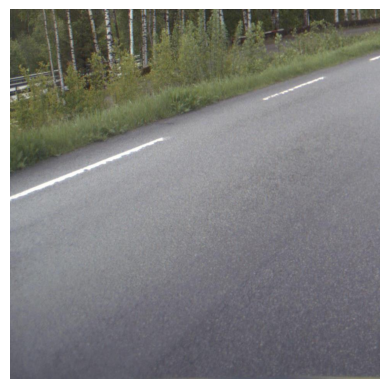

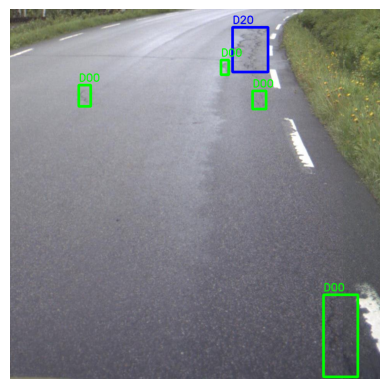

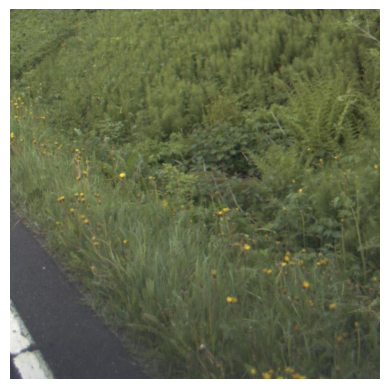

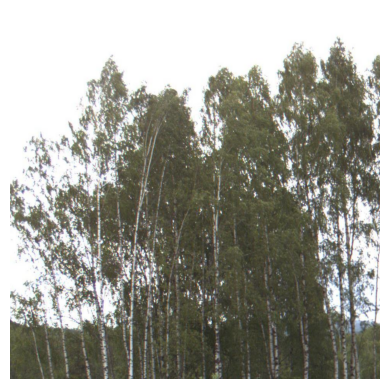

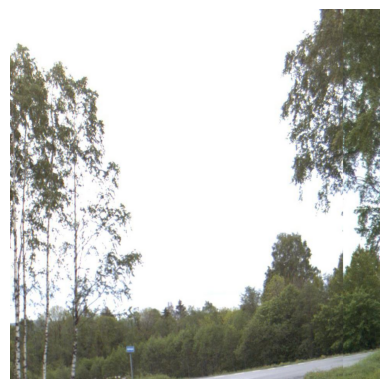

...

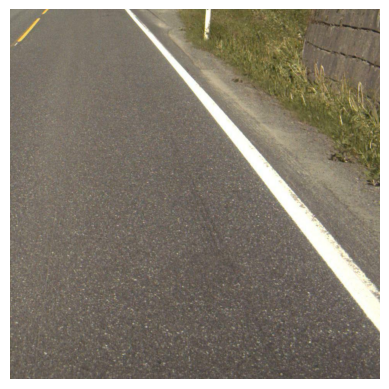

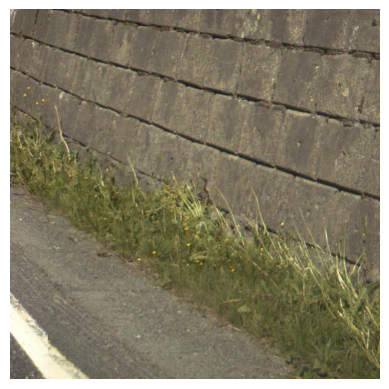

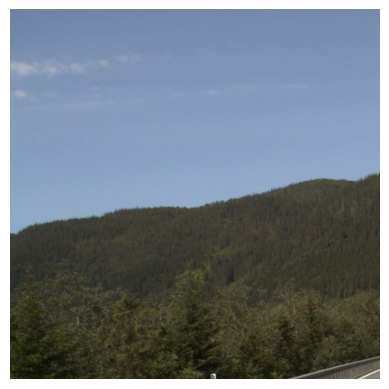

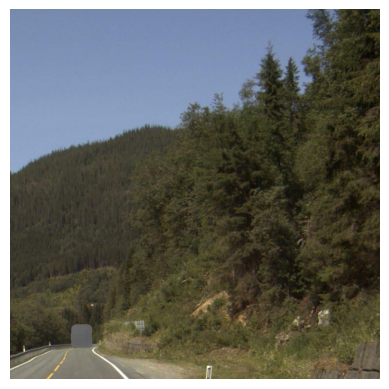

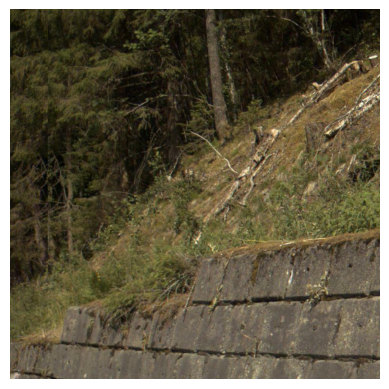

In [273]:
display_modified_images_with_boxes(modified_image_path, modified_annotation_path)